### Representing and Predicting SSP Dynamics using LMUs

We use an environment of a ball bouncing around a frictionless surface without loss in kinematic energy to create a time-series of SSPs which are then used to drive a high-dimensional LMU.

A two-layer MLP is used to learn $f : X \mapsto X$ where $X$ is the state of the LMU, the domain corresponds to the current history, and the range corresponds to the history fast-forwarded by 1.5 windows. In other words, the neural network learns to predict the representation of future trajectories. 

We also use the grid / place cell representation from "Accurate representation for spatial cognition using grid cells" (Nicole Sandra-Yaffa Dumont & Chris Eliasmith, 2020) to improve accuracy.

In [1]:
%matplotlib inline

In [2]:
import string

import numpy as np
from scipy.signal import cont2discrete

import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import HTML

import nengo
import nengo_spa as spa
from ssp.collisions import Simulation
from ssp.maps import Spatial2D
from ssp.plots import heatmap_animation, create_gif

In [3]:
# TODO: refactor common code with benchmarking and predicting_collision_dynamics into ssp/collisions.py

grid_size = 5  # in units of circle's diameter
n_particles = 1
radii = np.ones(n_particles) / grid_size / 2
dt = 0.4
frames = 500
interval = 40

MovieWriter imagemagick unavailable; using Pillow instead.



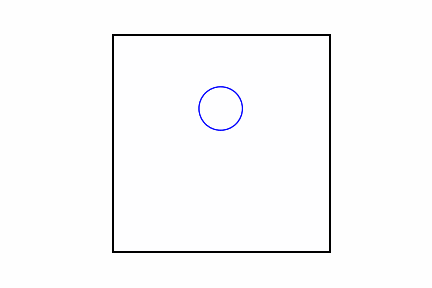

In [4]:
sim = Simulation(n_particles, radius=radii, rng=np.random.RandomState(seed=0))
ani = sim.do_animation(dt=dt, frames=frames, interval=interval)
HTML('<img src="data:image/gif;base64,{0}" />'.format(create_gif(ani, fname="environment.gif")))

In [5]:
# Adaoted from ssp_grid_cell_utils.py and ssp_grid_cell_examples.ipynb
# Accurate representation for spatial cognition using grid cells
# Nicole Sandra-Yaffa Dumont & Chris Eliasmith

def ssp_plane_basis(K):
    # Create the bases vectors X,Y as described in the paper with the wavevectors 
    # (k_i = (u_i,v_i)) given in a matrix K. To get hexganal patterns use 3 K vectors 120 degs apart
    # To get mulit-scales/orientation, give many such sets of 3 K vectors 
    # K is _ by 2 
    d = K.shape[0]
    FX = np.ones((d*2 + 1,), dtype="complex")
    FX[0:d] = np.exp(1.j*K[:,0])
    FX[-d:] = np.flip(np.conj(FX[0:d]))
    FX = np.fft.ifftshift(FX)
    FY = np.ones((d*2 + 1,), dtype="complex")
    FY[0:d] = np.exp(1.j*K[:,1])
    FY[-d:] = np.flip(np.conj(FY[0:d]))
    FY = np.fft.ifftshift(FY)
    
    X = spa.SemanticPointer(data=np.fft.ifft(FX))
    Y = spa.SemanticPointer(data=np.fft.ifft(FY))
    return X, Y


def generate_grid_cell_basis(n_scales, n_rotates, scale_min=0.5, scale_max=1.8):
    """Generates basis vectors with ``d = n_scales * n_rotates * 6 + 1``."""
    K_hex = np.array(
        [[0, 1],
         [np.sqrt(3) / 2, -0.5],
         [-np.sqrt(3) / 2, -0.5]]
    )

    # Combining multiple n_scales sets of 3 wave vectors that give hexagonal grid interference patterns
    # each set of 3 giving a different grid resolution
    scales = np.linspace(scale_min, scale_max, n_scales)
    K_scales = np.vstack([K_hex * i for i in scales])

    # Combining multiple n_rotates sets of 3 wave vectors that give hexagonal grid interference patterns
    # each set of 3 giving a different grid orientation
    thetas = np.arange(0, n_rotates) * np.pi / (3 * n_rotates)
    R_mats = np.stack([np.stack([np.cos(thetas), -np.sin(thetas)], axis=1),
                       np.stack([np.sin(thetas), np.cos(thetas)], axis=1)],
                      axis=1)
    # TODO: don't double transpose
    K_rotates = (R_mats @ K_hex.T).transpose(1, 2, 0).T.reshape(-1, 2)

    # Multiple resolutions and orientations
    # TODO: don't double transpose
    K_scale_rotates = (R_mats @ K_scales.T).transpose(1, 2, 0).T.reshape(-1, 2)

    # Generate the (X, Y) basis vectors
    X, Y = ssp_plane_basis(K_scale_rotates)
    d = n_scales * n_rotates * 6 + 1
    assert len(X) == len(Y) == d
    return X, Y, d

In [6]:
# points in the simulation are within [0, 1]^2 and then visualized
# on [-0.5, 0.5]^2 with a scale of sqrt(2)*grid_size such
# that the diameter of each ball is roughly the same scale

ssp_radius = np.sqrt(2)  # open problem: deriving this
ssp_scale = ssp_radius * grid_size

X, Y, d = generate_grid_cell_basis(n_scales=10, n_rotates=9,
                                   scale_min=0.9, scale_max=3.5)
dim = d
print("Dimensionality:", d)

ssp_map = Spatial2D(dim=dim, scale=ssp_scale, X=X, Y=Y, rng=np.random.RandomState(seed=0))

ssp_map.build_grid(x_len=1, y_len=1, x_spaces=101, y_spaces=101)

names = string.ascii_uppercase[:n_particles]
assert len(names) == n_particles

/home/ns2dumon/anaconda3/envs/ssp/lib/python3.7/site-packages/nengo_spa/semantic_pointer.py:57: ComplexWarning: Casting complex values to real discards the imaginary part
  self.v = np.array(data, dtype=float)


Dimensionality: 541


In [7]:
# Create the LMU system from Voelker et al., 2019
# https://www.nengo.ai/nengo-dl/examples/lmu.html

order = 12
theta = 10  # in discrete time-steps

Q = np.arange(order, dtype=np.float64)
R = (2 * Q + 1)[:, None] / theta
j, i = np.meshgrid(Q, Q)

A = np.where(i < j, -1, (-1.0) ** (i - j + 1)) * R
B = (-1.0) ** Q[:, None] * R
C = np.ones((1, order))
D = np.zeros((1,))

A, B, _, _, _ = cont2discrete((A, B, C, D), dt=1.0, method="zoh")

In [134]:
def generate_lmu_data(n_seeds, n_frames_per_seed, start_seed=0):
    states = np.zeros((n_seeds, n_frames_per_seed, order, ssp_map.voc.dimensions))
    zero = np.zeros((order, ssp_map.voc.dimensions))
    
    for seed in range(n_seeds):
        sim = Simulation(
            n_particles,
            radius=radii,
            rng=np.random.RandomState(seed=seed + start_seed),
        )

        for step in range(n_frames_per_seed):
            ssp = ssp_map.encode_points(sim.x, sim.y, names)

            last_state = states[seed, step-1, :, :] if step else zero
            states[seed, step, :, :] = A.dot(last_state) + B * ssp.v

            sim.advance(dt)

    return states


states = generate_lmu_data(n_seeds=100, n_frames_per_seed=100)

In [135]:
train_states = states

In [9]:
# Use the Legendre basis to read out the state of the LMU to see what
# it is representing (purely for visualization)

n_visualize = 5  # number of samples in history to visualize

from scipy.special import legendre
t = np.linspace(0, 1, n_visualize)
basis = np.asarray([legendre(i)(2*t - 1) for i in range(order)])

MovieWriter imagemagick unavailable; using Pillow instead.



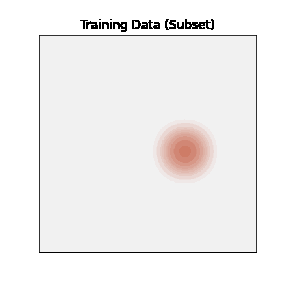

In [10]:
# Visualize some of the history training data
# Everything will be done in the Legendre space, but it is still helpful
# to see what it is representing along a number of samples in the window

heatmaps = []
for step in range(frames):
    # Add together all the points in the history 
    state = states[step // states.shape[1], step % states.shape[1]]
    history = spa.SemanticPointer(
        np.sum(basis.T.dot(state), axis=0))

    heatmaps.append(
        ssp_map.compute_heatmap(history, names=names)
    )

ani = heatmap_animation([heatmaps], figsize=(4, 4), interval=interval,
                        titles=['Training Data (Subset)'])
HTML('<img src="data:image/gif;base64,{0}" />'.format(create_gif(ani, fname="ssphist.gif")))

In [11]:
predict_steps = 15

shape_flat = (states.shape[0] * (states.shape[1] - predict_steps),
              states.shape[2] * states.shape[3])

train_input = states[:, :-predict_steps].reshape(shape_flat)
train_output = states[:, predict_steps:].reshape(shape_flat)


In [12]:
from ssp.models import MLP

mlp = MLP(order * ssp_map.voc.dimensions, [1024, 1024], order * ssp_map.voc.dimensions)
mlp.train(train_input, train_output, n_steps=5000)

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

In [ ]:
mlp.model.summary()

In [14]:
# first axis is squeezed (n_seeds=1) and so len(states) == frames
assert len(states) == frames

# Use D to predict future windows
states_flat = states.reshape((len(states), -1))

#pred_states = states_flat.dot(D).reshape((len(states), order, ssp_map.voc.dimensions))
pred_states = np.asarray(mlp(states_flat)).reshape((len(states), order, ssp_map.voc.dimensions))

In [15]:
t = np.linspace(0, 1, 5)
pred_basis = np.asarray([legendre(i)(2*t - 1) for i in range(order)])

MovieWriter imagemagick unavailable; using Pillow instead.



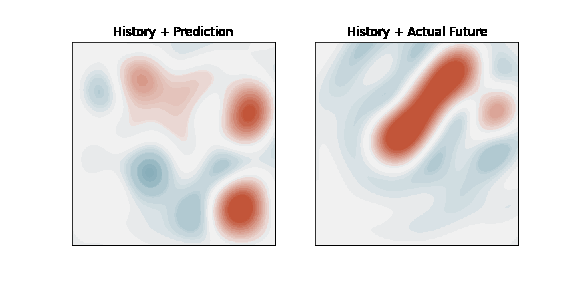

In [16]:
# Put it together to visualize the history along with predictions and ground truth
heatmaps = []

for step in range(frames - predict_steps):
    # Add together all the points in the history 
    history = spa.SemanticPointer(
        np.sum(basis.T.dot(states[step]), axis=0))

    # Add together all the points in the prediction 
    pred = spa.SemanticPointer(
        np.sum(pred_basis.T.dot(pred_states[step]), axis=0))

    # Add together all the points in the future 
    future = spa.SemanticPointer(
        np.sum(pred_basis.T.dot(states[step + predict_steps]), axis=0))

    # Show all three separately
    heatmaps.append(
        [ssp_map.compute_heatmap(history + pred, names=names),
         ssp_map.compute_heatmap(history + future, names=names),
        ]
    )

ani = heatmap_animation(list(zip(*heatmaps)), figsize=(8, 4), interval=interval,
                        titles=['History + Prediction', 'History + Actual Future'])
HTML('<img src="data:image/gif;base64,{0}" />'.format(create_gif(ani, fname="ssppred.gif")))

In [105]:
# Decode coordinates represented by history, future, prediction, etc. for plotting


ssp_map.decode_threshold = 0.1

his_coord = []
fut_coord = []
pred_coord = []
sims = []
sims2 = []
for step in range(frames - predict_steps):
    his_ssp = np.flip(basis.T.dot(states[step]), axis=0)
    fut_ssp = np.flip(pred_basis.T.dot(states[step + predict_steps]), axis=0)
    pred_ssp = np.flip(pred_basis.T.dot(pred_states[step]), axis=0)
    for i in range(his_ssp.shape[0]):
        his_coord.append(ssp_map.decode_ssp_coords(spa.SemanticPointer(his_ssp[i,:]), name=names))
        fut_coord.append(ssp_map.decode_ssp_coords(spa.SemanticPointer(fut_ssp[i,:]), name=names))
        predcres = ssp_map.decode_ssp_coords(spa.SemanticPointer(pred_ssp[i,:]), name=names)
        pred_coord.append(predcres)
        pred_ssp2 = ssp_map.encode_point(predcres[0],predcres[1] )
        sims.append(np.sum(fut_ssp[i,:]*pred_ssp[i,:]))
        sims2.append(np.sum((spa.SemanticPointer(fut_ssp[i,:]) * ~ssp_map.voc[names]).v*pred_ssp2.v))

In [18]:
import seaborn as sns
sns.set_context('paper')

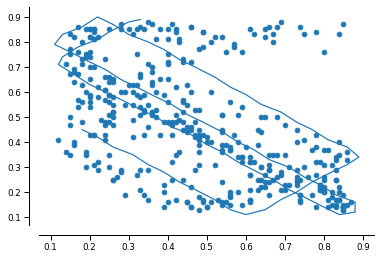

In [19]:
his_coord_v = np.array(his_coord)[0::n_visualize]
fut_coord_v = np.array(fut_coord)
pred_coord_v = np.array(pred_coord)

nfor = 80
state_range = np.arange(nfor*n_visualize)
state_range2 = np.arange(nfor)
plt.figure()
plt.plot(his_coord_v[state_range2,0],his_coord_v[state_range2,1])
plt.scatter(pred_coord_v[state_range,0],pred_coord_v[state_range,1])
#for i in np.arange(0,nfor*n_visualize,5):
#      plt.scatter(pred_coord_v[i:(5+i),0],pred_coord_v[i:(5+i),1])
#plt.legend(['Path','Future prediction'])
sns.despine(offset=10)


plt.savefig('ex_preds.png')
plt.savefig('ex_preds.pdf')

/home/ns2dumon/anaconda3/envs/ssp/lib/python3.7/site-packages/ipykernel_launcher.py:18: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
/home/ns2dumon/anaconda3/envs/ssp/lib/python3.7/site-packages/ipykernel_launcher.py:23: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.


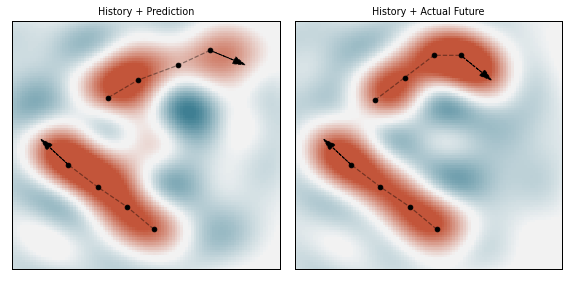

In [111]:
idx = 80

def drawpath(ax,coord):
    ax.plot(coord[:,0],coord[:,1],linestyle='--',color='black', alpha=0.4)
    ax.scatter(coord[:-1,0],coord[:-1,1],color='black')
    ax.arrow(coord[-2,0],coord[-2,1], 
                  coord[-1,0]-coord[-2,0],coord[-1,1]-coord[-2,1], 
                  width=0,length_includes_head=False, head_width=0.03, color='black',ls='--')

his_coord_idx = np.array(his_coord[(idx*n_visualize):((idx+1)*n_visualize)])
fut_coord_idx = np.array(fut_coord[(idx*n_visualize):((idx+1)*n_visualize)])
pred_coord_idx = np.array(pred_coord[(idx*n_visualize):((idx+1)*n_visualize)])


cmap=sns.diverging_palette(220, 20, sep=20, as_cmap=True)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 4))
axes[0].pcolormesh(ssp_map.xs, ssp_map.ys, heatmaps[idx][0].T,vmin=-1, vmax=1, cmap=cmap)
axes[0].title.set_text('History + Prediction')
drawpath(axes[0],his_coord_idx)
drawpath(axes[0],pred_coord_idx)

axes[1].pcolormesh(ssp_map.xs, ssp_map.ys, heatmaps[idx][1].T,vmin=-1, vmax=1, cmap=cmap)
axes[1].title.set_text('History + Actual Future')
drawpath(axes[1],his_coord_idx)
drawpath(axes[1],fut_coord_idx)
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    
fig.tight_layout()
plt.savefig('lmu_ex.png')
plt.savefig('lmu_ex.pdf')

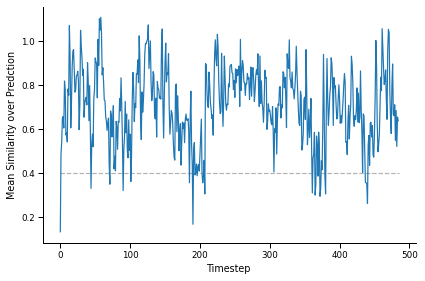

In [112]:
# Simarity of prediction SSPs to true future SSPs averaged over full window at each time

plt.figure()
#plt.plot([0,len(heatmaps)],[0.4,0.4], linestyle='--',color='black',alpha=0.3)
plt.plot([np.mean(sims[s]) for s in np.arange(0,len(sims),n_visualize)])
#plt.plot([np.mean(sims2[s]) for s in np.arange(0,len(sims2),n_visualize)])

sns.despine()
plt.xlabel('Timestep')
plt.ylabel('Mean Similarity over Predction')
plt.tight_layout()

plt.savefig('mean_sim_preds.png')
plt.savefig('mean_sim_preds.pdf')


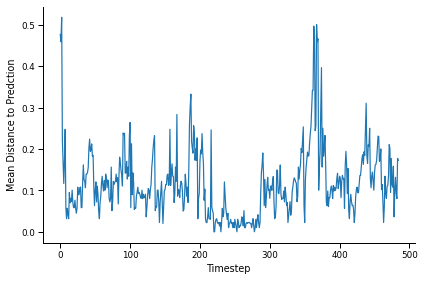

In [113]:
# Distance of decoded coordinates from prediction to true coordinates averaged over full window at each time


dists = np.linalg.norm(fut_coord_v-pred_coord_v,axis=1) 
plt.figure()
plt.plot([np.mean(dists[s]) for s in np.arange(0,len(dists),n_visualize)])
sns.despine()
plt.xlabel('Timestep')
plt.ylabel('Mean Distance to Predction')
plt.tight_layout()
plt.savefig('mean_dist_preds.png')
plt.savefig('mean_dist_preds.pdf')